# Setup and Packages

In [1]:
import os
import shutil
import pandas as pd
import numpy as np
import glob
from sklearn.metrics import mean_squared_error
import matplotlib as plt
import chardet
from sklearn.metrics import mean_absolute_error, mean_squared_error
import seaborn as sns
import biometeo
from pythermalcomfort.models import pet_steady
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt

# Extraction of all Vlinder csv files Vlinder01_data_aug_rayman to 75 as Dataframe. August 2022.

Function to check for missing values, data types of each column and non-numeric columns

In [3]:
def check_dataframe_for_ml(dataframe):

    result = {}
    missing_values = dataframe.isnull().sum()
    result['missing_values'] = missing_values.to_dict()

    data_types = dataframe.dtypes
    result['data_types'] = data_types.to_dict()

    non_numeric_columns = data_types[data_types != 'int64'][data_types != 'float64'].index
    result['non_numeric_columns'] = non_numeric_columns.tolist()

    return result

In [4]:

# Set the source directory where the folders are located
source_directory = r'D:\Vub\Thesis\Data\db22'

# Set the destination directory where you want to copy the CSV files
destination_directory = r'D:\Vub\Thesis\DataToUse'

# Loop through folders fwith vlinder data
for i in range(1, 76):
    folder_name = f'Vlinder{i:02}' 
    folder_path = os.path.join(source_directory, folder_name, 'data')

    # Check if subdirectory exists in the folder 
    if os.path.exists(folder_path):

        csv_file_name = f'{folder_name}_data_aug_rayman.csv'
        csv_file_path = os.path.join(folder_path, csv_file_name)

        if os.path.exists(csv_file_path):
            destination_path = os.path.join(destination_directory, csv_file_name)
            shutil.copy(csv_file_path, destination_path)
            print(f'Copied {csv_file_name} to {destination_path}')
        else:
            print(f'CSV file {csv_file_name} not found in {folder_name}/data')
    else:
        print(f'Data subdirectory not found in {folder_name}')

print("Processing completed.")


Copied Vlinder01_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder01_data_aug_rayman.csv
Copied Vlinder02_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder02_data_aug_rayman.csv
Copied Vlinder03_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder03_data_aug_rayman.csv
Copied Vlinder04_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder04_data_aug_rayman.csv
Copied Vlinder05_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder05_data_aug_rayman.csv
Copied Vlinder06_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder06_data_aug_rayman.csv
Copied Vlinder07_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder07_data_aug_rayman.csv
Copied Vlinder08_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder08_data_aug_rayman.csv
Copied Vlinder09_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder09_data_aug_rayman.csv
Copied Vlinder10_data_aug_rayman.csv to D:\Vub\Thesis\DataToUse\Vlinder10_data_aug_rayman.csv
Copied Vlinder11_data_aug_rayman.csv to D:\Vub\Thesis\DataTo

In [5]:
dataframes = []

# Loop through files in the destination directory
for filename in os.listdir(destination_directory):
    if filename.endswith(".csv"):
        file_path = os.path.join(destination_directory, filename)
        
        df_temp = pd.read_csv(file_path, delimiter='\t')
        
        # Rename the columns for English
        df_temp.rename(columns={
            'date': 'Date',
            'time': 'Time',
            'Temperatuur': 'Temp',
            'Vochtigheid': 'Humid',
            'Windsnelheid': 'WindSpeed'
        }, inplace=True)
        
        dataframes.append(df_temp)

# Concatenate all DataFrames into a single DataFrame and reset the index
if dataframes:
    combined_dataframe = pd.concat(dataframes, ignore_index=True)
    
    # Drop rows with missing values if they exists (NaN) and reset index
    combined_dataframe.dropna(subset=["Date", "Time", "Temp", "Humid", "WindSpeed"], inplace=True)
    combined_dataframe.reset_index(drop=True, inplace=True)

    print(combined_dataframe.tail())
else:
    print("No CSV files found in the destination directory.")


       date\ttime\tTemperature\tHumidity\tWindSpeed       Date   Time  Temp  \
104938                                          NaN  31.8.2022  21:30  20.3   
104939                                          NaN  31.8.2022  22:00  20.1   
104940                                          NaN  31.8.2022  22:30  19.7   
104941                                          NaN  31.8.2022  23:00  19.1   
104942                                          NaN  31.8.2022  23:30  18.7   

        Humid  WindSpeed  
104938   57.0        0.9  
104939   57.0        1.4  
104940   57.0        1.1  
104941   58.0        0.8  
104942   58.0        0.8  


Save Dataframe

In [6]:
combined_dataframe.head()
combined_dataframe.to_csv('Input_Rayman_combined_dataframe.csv', index=False)

Checking dataframe

In [7]:
result = check_dataframe_for_ml(combined_dataframe)
print("Missing Values:")
print(result['missing_values'])
print("Data Types:")
print(result['data_types'])
print("Non-numeric Columns:")
print(result['non_numeric_columns'])

Missing Values:
{'date\ttime\tTemperature\tHumidity\tWindSpeed': 104943, 'Date': 0, 'Time': 0, 'Temp': 0, 'Humid': 0, 'WindSpeed': 0}
Data Types:
{'date\ttime\tTemperature\tHumidity\tWindSpeed': dtype('O'), 'Date': dtype('O'), 'Time': dtype('O'), 'Temp': dtype('float64'), 'Humid': dtype('float64'), 'WindSpeed': dtype('float64')}
Non-numeric Columns:
['date\ttime\tTemperature\tHumidity\tWindSpeed', 'Date', 'Time']


# Extracting Rayman Output from Rayman_output

In [8]:
source_directory = 'D:\Vub\Thesis\Data\db22\Rayman_output'
destination_directory = 'D:\Vub\Thesis\RaymanOutput'

rayman_output_df = pd.DataFrame()

# Loop through each text file in the source directory matching the pattern of data
for txt_file in glob.glob(os.path.join(source_directory, 'Vlinder*_aug_rayman_output.txt')):
    try:
        # Attempt to read the file with different encodings in case of an error
        df = pd.read_csv(txt_file, skiprows=2, delimiter='\t', encoding='ISO-8859-1')
    except UnicodeDecodeError:
        df = pd.read_csv(txt_file, skiprows=2, delimiter='\t', encoding='utf-8')
    
    csv_filename = os.path.basename(txt_file).replace('_rayman_output.txt', '.csv')
    
    df.to_csv(os.path.join(destination_directory, csv_filename), index=False)

    rayman_output_df = pd.concat([rayman_output_df, df], ignore_index=True)

combined_csv_path = os.path.join(destination_directory, 'rayman_output_df.csv')
rayman_output_df.to_csv(combined_csv_path, index=False)

<>:2: DeprecationWarning: invalid escape sequence '\V'
<>:3: DeprecationWarning: invalid escape sequence '\V'
<>:2: DeprecationWarning: invalid escape sequence '\V'
<>:3: DeprecationWarning: invalid escape sequence '\V'
C:\Users\Lukasz\AppData\Local\Temp\ipykernel_28172\206829706.py:2: DeprecationWarning: invalid escape sequence '\V'
  source_directory = 'D:\Vub\Thesis\Data\db22\Rayman_output'
C:\Users\Lukasz\AppData\Local\Temp\ipykernel_28172\206829706.py:3: DeprecationWarning: invalid escape sequence '\V'
  destination_directory = 'D:\Vub\Thesis\RaymanOutput'


## Correcting formatting

In [9]:
# Drop the 'Unnamed: 36' column 
rayman_output_df = rayman_output_df.drop('Unnamed: 36', axis=1)

# Combine the current column names with their formats from the first row to create new column names
new_columns_names = [f"{name}[{units}]" for name, units in zip(rayman_output_df.columns, rayman_output_df.iloc[0])]
rayman_output_df.columns = new_columns_names

# Drop the first row used for column names and reset the index
rayman_output_df.drop(index=0, inplace=True)
rayman_output_df.reset_index(drop=True, inplace=True)

In total 74 missing values

In [10]:
rayman_output_df = rayman_output_df.dropna()
rayman_output_df.reset_index(drop=True, inplace=True)

In [11]:
rayman_output_df

,date [d.m.yyyy ],day of[year],time[h:mm],sunr.[h:mm],sunset[h:mm],SDmax[min],SDact[min],elev.[°],azim.[°],SVF_Ray[nan],SVF_cos[nan],LTF[nan],Albedo[nan],Bowen[nan],Gmax[W/m²],Gact[W/m²],Sact[W/m²],Dact[W/m²],A[W/m²],E[W/m²],Ts[°C],Ta[°C],VP[hPa],RH[%],v[m/s],C[octas],Tmrt[°C],height[m],weight[kg],age[a],sex[nan],cloth.[clo],activ.[W],PET[°C],UTCI[°C],PT[°C]
0,1.8.2022,213,0:00,5:08,20:29,921,917,-20.3,347.7,1.0,1.0,4.3,0.3,1.0,0.0,0.0,0.0,0.0,337.2,399.0,17.1,19.0,19.5,89.0,1.1,0.0,10.7,1.8,75.0,35,m,0.90,80.0,13.7,16.7,13.3
1,1.8.2022,213,0:30,5:08,20:29,921,917,-21.0,355.3,1.0,1.0,6.2,0.3,1.0,0.0,0.0,0.0,0.0,335.9,396.7,16.6,18.7,19.6,91.0,0.9,0.0,10.4,1.8,75.0,35,m,0.90,80.0,13.5,16.9,13.3
2,1.8.2022,213,1:00,5:08,20:29,921,917,-21.1,2.9,1.0,1.0,8.6,0.3,1.0,0.0,0.0,0.0,0.0,335.4,396.9,16.7,18.6,19.7,92.0,1.1,0.0,10.3,1.8,75.0,35,m,0.90,80.0,13.3,16.4,13.0
3,1.8.2022,213,1:30,5:08,20:29,921,917,-20.5,10.5,1.0,1.0,8.6,0.3,1.0,0.0,0.0,0.0,0.0,335.4,396.9,16.7,18.6,19.7,92.0,1.1,0.0,10.3,1.8,75.0,35,m,0.90,80.0,13.3,16.4,13.0
4,1.8.2022,213,2:00,5:08,20:29,921,917,-19.3,18.0,1.0,1.0,13.0,0.3,1.0,0.0,0.0,0.0,0.0,335.5,396.2,16.5,18.6,19.9,93.0,0.9,0.0,10.3,1.8,75.0,35,m,0.90,80.0,13.4,16.9,13.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106413,31.8.2022,243,21:30,5:53,19:31,818,816,-17.5,309.6,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,339.3,404.5,18.1,20.3,13.6,57.0,0.9,0.0,11.4,1.8,75.0,35,m,0.90,80.0,14.8,16.8,14.0
106414,31.8.2022,243,22:00,5:53,19:31,818,816,-20.9,316.5,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,338.1,405.2,18.2,20.1,13.4,57.0,1.4,0.0,11.4,1.8,75.0,35,m,0.90,80.0,14.3,15.6,13.5
106415,31.8.2022,243,22:30,5:53,19:31,818,816,-23.9,323.8,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,335.9,401.9,17.6,19.7,13.1,57.0,1.1,0.0,10.9,1.8,75.0,35,m,0.90,80.0,14.0,15.8,13.3
106416,31.8.2022,243,23:00,5:53,19:31,818,816,-26.5,331.5,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,332.8,397.4,16.8,19.1,12.8,58.0,0.8,0.0,10.1,1.8,75.0,35,m,0.90,80.0,13.6,15.7,13.0


Save to csv

In [13]:
rayman_output_df.to_csv("Rayman_output_with_SVF.csv", index=False)

In [14]:
result = check_dataframe_for_ml(rayman_output_df)
print("Missing Values:")
print(result['missing_values'])
print("Data Types:")
print(result['data_types'])
print("Non-numeric Columns:")
print(result['non_numeric_columns'])

Missing Values:
{'date      [d.m.yyyy   ]': 0, 'day of[year]': 0, 'time[h:mm]': 0, 'sunr.[h:mm]': 0, 'sunset[h:mm]': 0, 'SDmax[min]': 0, 'SDact[min]': 0, 'elev.[°]': 0, 'azim.[°]': 0, 'SVF_Ray[nan]': 0, 'SVF_cos[nan]': 0, 'LTF[nan]': 0, 'Albedo[nan]': 0, 'Bowen[nan]': 0, 'Gmax[W/m²]': 0, 'Gact[W/m²]': 0, 'Sact[W/m²]': 0, 'Dact[W/m²]': 0, 'A[W/m²]': 0, 'E[W/m²]': 0, 'Ts[°C]': 0, 'Ta[°C]': 0, 'VP[hPa]': 0, 'RH[%]': 0, 'v[m/s]': 0, 'C[octas]': 0, 'Tmrt[°C]': 0, 'height[m]': 0, 'weight[kg]': 0, 'age[a]': 0, 'sex[nan]': 0, 'cloth.[clo]': 0, 'activ.[W]': 0, 'PET[°C]': 0, 'UTCI[°C]': 0, 'PT[°C]': 0}
Data Types:
{'date      [d.m.yyyy   ]': dtype('O'), 'day of[year]': dtype('O'), 'time[h:mm]': dtype('O'), 'sunr.[h:mm]': dtype('O'), 'sunset[h:mm]': dtype('O'), 'SDmax[min]': dtype('O'), 'SDact[min]': dtype('O'), 'elev.[°]': dtype('O'), 'azim.[°]': dtype('O'), 'SVF_Ray[nan]': dtype('float64'), 'SVF_cos[nan]': dtype('float64'), 'LTF[nan]': dtype('float64'), 'Albedo[nan]': dtype('float64'), 'Bowen[n

# Ray Man 

In [15]:
def drop_columns_with_nans(dataframe, threshold=0.9):
    # check percentage of NaN values in each column
    nan_percentages = dataframe.isna().sum() / len(dataframe)
    
    # Identify columns where nana values exceed the threshol
    columns_to_drop = nan_percentages[nan_percentages > threshold].index

    dataframe_dropped = dataframe.drop(columns=columns_to_drop)
    
    return dataframe_dropped



In [16]:
def readRaymanOutput(file_path, csv_file_path):
    with open(file_path, 'rb') as f:
        rawdata = f.read(100)

    # Detect the encoding of the raw data
    result = chardet.detect(rawdata)

    file_encoding = result['encoding']

    print(f"The detected encoding of the file is: {file_encoding}")

    # Read the data from the text file and skip the first two lines with column names and units
    with open(file_path, 'r', encoding=file_encoding) as file:
        lines = file.readlines()[2:]

    with open(csv_file_path, 'w', newline='') as file:
        header = "\t".join(lines[0].split())
        file.write(header + '\n')

        for line in lines[1:]:
            file.write(line)

    # Load the data into a DataFrame with the extracted encoding
    dataframe = pd.read_csv(csv_file_path, delimiter='\t', encoding=file_encoding, skiprows=0)
    dataframe = drop_columns_with_nans(dataframe)
 
    #Combine the current column names with their formats from the first row to create new column names
    new_columns_names = [f"{name}[{units}]" for name, units in zip(dataframe.columns, dataframe.iloc[0])]
    dataframe.columns = new_columns_names

    dataframe.drop(index=0, inplace=True)

    dataframe = dataframe.dropna()
    dataframe.reset_index(drop=True, inplace=True)

    # Check the dataframe
    result = check_dataframe_for_ml(dataframe)
    print("Missing Values:")
    print(result['missing_values'])
    print("Data Types:")
    print(result['data_types'])
    print("Non-numeric Columns:")
    print(result['non_numeric_columns'])

    return dataframe

## Modifying output with different SVF Values for SVF test

In [17]:
rayman104 = readRaymanOutput("0.104SVF.txt", "rayman_104SVF.csv")
rayman104.tail()

The detected encoding of the file is: ISO-8859-1


C:\Users\Lukasz\AppData\Local\Temp\ipykernel_28172\3179841652.py:30: DtypeWarning: Columns (1,3,4,5,6,9,10,11,12,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,35,36,37) have mixed types. Specify dtype option on import or set low_memory=False.
  dataframe = pd.read_csv(csv_file_path, delimiter='\t', encoding=file_encoding, skiprows=0)


Missing Values:
{'date      [d.m.yyyy   ]': 0, 'day of[year]': 0, 'time[h:mm]': 0, 'Latit.[°N]': 0, 'Long.[°E]': 0, 'Altit.[m]': 0, 'UTC[h]': 0, 'sunr.[h:mm]': 0, 'sunset[h:mm]': 0, 'SDmax[min]': 0, 'SDact[min]': 0, 'elev.[°]': 0, 'azim.[°]': 0, 'SVF_Ray[nan]': 0, 'SVF_cos[nan]': 0, 'LTF[nan]': 0, 'Albedo[nan]': 0, 'Bowen[nan]': 0, 'Gmax[W/m²]': 0, 'Gact[W/m²]': 0, 'Sact[W/m²]': 0, 'Dact[W/m²]': 0, 'A[W/m²]': 0, 'E[W/m²]': 0, 'Ts[°C]': 0, 'Ta[°C]': 0, 'VP[hPa]': 0, 'RH[%]': 0, 'v[m/s]': 0, 'C[octas]': 0, 'Tmrt[°C]': 0, 'height[m]': 0, 'weight[kg]': 0, 'age[a]': 0, 'sex[nan]': 0, 'cloth.[clo]': 0, 'activ.[W]': 0, 'PET[°C]': 0}
Data Types:
{'date      [d.m.yyyy   ]': dtype('O'), 'day of[year]': dtype('O'), 'time[h:mm]': dtype('O'), 'Latit.[°N]': dtype('O'), 'Long.[°E]': dtype('O'), 'Altit.[m]': dtype('O'), 'UTC[h]': dtype('O'), 'sunr.[h:mm]': dtype('O'), 'sunset[h:mm]': dtype('O'), 'SDmax[min]': dtype('O'), 'SDact[min]': dtype('O'), 'elev.[°]': dtype('O'), 'azim.[°]': dtype('O'), 'SVF_Ra

,date [d.m.yyyy ],day of[year],time[h:mm],Latit.[°N],Long.[°E],Altit.[m],UTC[h],sunr.[h:mm],sunset[h:mm],SDmax[min],SDact[min],elev.[°],azim.[°],SVF_Ray[nan],SVF_cos[nan],LTF[nan],Albedo[nan],Bowen[nan],Gmax[W/m²],Gact[W/m²],Sact[W/m²],Dact[W/m²],A[W/m²],E[W/m²],Ts[°C],Ta[°C],VP[hPa],RH[%],v[m/s],C[octas],Tmrt[°C],height[m],weight[kg],age[a],sex[nan],cloth.[clo],activ.[W],PET[°C]
106413,31.8.2022,243,21:30,50.83,4.35,0,1.0,5:53,19:31,818,37,-17.5,309.6,0.104,0.151,3.9,0.3,1.0,0.0,0.0,0.0,0.0,339.3,418.1,20.0,20.3,13.6,57.0,0.9,0.0,19.0,1.8,75.0,35,m,0.9,80.0,17.2
106414,31.8.2022,243,22:00,50.83,4.35,0,1.0,5:53,19:31,818,37,-20.9,316.5,0.104,0.151,3.9,0.3,1.0,0.0,0.0,0.0,0.0,338.1,417.2,19.8,20.1,13.4,57.0,1.4,0.0,18.9,1.8,75.0,35,m,0.9,80.0,16.4
106415,31.8.2022,243,22:30,50.83,4.35,0,1.0,5:53,19:31,818,37,-23.9,323.8,0.104,0.151,3.9,0.3,1.0,0.0,0.0,0.0,0.0,335.9,414.8,19.4,19.7,13.1,57.0,1.1,0.0,18.4,1.8,75.0,35,m,0.9,80.0,16.3
106416,31.8.2022,243,23:00,50.83,4.35,0,1.0,5:53,19:31,818,37,-26.5,331.5,0.104,0.151,3.9,0.3,1.0,0.0,0.0,0.0,0.0,332.8,411.2,18.8,19.1,12.8,58.0,0.8,0.0,17.8,1.8,75.0,35,m,0.9,80.0,16.1
106417,31.8.2022,243,23:30,50.83,4.35,0,1.0,5:53,19:31,818,37,-28.4,339.6,0.104,0.151,3.9,0.3,1.0,0.0,0.0,0.0,0.0,330.5,408.9,18.4,18.7,12.5,58.0,0.8,0.0,17.4,1.8,75.0,35,m,0.9,80.0,15.7


In [18]:
rayman001 = readRaymanOutput("0.001SVF.txt", "rayman_001SVF.csv")
rayman001.tail()

The detected encoding of the file is: ISO-8859-1


C:\Users\Lukasz\AppData\Local\Temp\ipykernel_28172\3179841652.py:30: DtypeWarning: Columns (1,3,4,5,6,9,10,11,12,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,35,36,37) have mixed types. Specify dtype option on import or set low_memory=False.
  dataframe = pd.read_csv(csv_file_path, delimiter='\t', encoding=file_encoding, skiprows=0)


Missing Values:
{'date      [d.m.yyyy   ]': 0, 'day of[year]': 0, 'time[h:mm]': 0, 'Latit.[°N]': 0, 'Long.[°E]': 0, 'Altit.[m]': 0, 'UTC[h]': 0, 'sunr.[h:mm]': 0, 'sunset[h:mm]': 0, 'SDmax[min]': 0, 'SDact[min]': 0, 'elev.[°]': 0, 'azim.[°]': 0, 'SVF_Ray[nan]': 0, 'SVF_cos[nan]': 0, 'LTF[nan]': 0, 'Albedo[nan]': 0, 'Bowen[nan]': 0, 'Gmax[W/m²]': 0, 'Gact[W/m²]': 0, 'Sact[W/m²]': 0, 'Dact[W/m²]': 0, 'A[W/m²]': 0, 'E[W/m²]': 0, 'Ts[°C]': 0, 'Ta[°C]': 0, 'VP[hPa]': 0, 'RH[%]': 0, 'v[m/s]': 0, 'C[octas]': 0, 'Tmrt[°C]': 0, 'height[m]': 0, 'weight[kg]': 0, 'age[a]': 0, 'sex[nan]': 0, 'cloth.[clo]': 0, 'activ.[W]': 0, 'PET[°C]': 0}
Data Types:
{'date      [d.m.yyyy   ]': dtype('O'), 'day of[year]': dtype('O'), 'time[h:mm]': dtype('O'), 'Latit.[°N]': dtype('O'), 'Long.[°E]': dtype('O'), 'Altit.[m]': dtype('O'), 'UTC[h]': dtype('O'), 'sunr.[h:mm]': dtype('O'), 'sunset[h:mm]': dtype('O'), 'SDmax[min]': dtype('O'), 'SDact[min]': dtype('O'), 'elev.[°]': dtype('O'), 'azim.[°]': dtype('O'), 'SVF_Ra

,date [d.m.yyyy ],day of[year],time[h:mm],Latit.[°N],Long.[°E],Altit.[m],UTC[h],sunr.[h:mm],sunset[h:mm],SDmax[min],SDact[min],elev.[°],azim.[°],SVF_Ray[nan],SVF_cos[nan],LTF[nan],Albedo[nan],Bowen[nan],Gmax[W/m²],Gact[W/m²],Sact[W/m²],Dact[W/m²],A[W/m²],E[W/m²],Ts[°C],Ta[°C],VP[hPa],RH[%],v[m/s],C[octas],Tmrt[°C],height[m],weight[kg],age[a],sex[nan],cloth.[clo],activ.[W],PET[°C]
106413,31.8.2022,243,21:30,50.83,4.35,0,1.0,5:53,19:31,818,0,-17.5,309.6,0.001,0.001,3.9,0.3,1.0,0.0,0.0,0.0,0.0,339.3,419.6,20.2,20.3,13.6,57.0,0.9,0.0,19.9,1.8,75.0,35,m,0.9,80.0,17.5
106414,31.8.2022,243,22:00,50.83,4.35,0,1.0,5:53,19:31,818,0,-20.9,316.5,0.001,0.001,3.9,0.3,1.0,0.0,0.0,0.0,0.0,338.1,418.6,20.0,20.1,13.4,57.0,1.4,0.0,19.7,1.8,75.0,35,m,0.9,80.0,16.6
106415,31.8.2022,243,22:30,50.83,4.35,0,1.0,5:53,19:31,818,0,-23.9,323.8,0.001,0.001,3.9,0.3,1.0,0.0,0.0,0.0,0.0,335.9,416.2,19.6,19.7,13.1,57.0,1.1,0.0,19.3,1.8,75.0,35,m,0.9,80.0,16.6
106416,31.8.2022,243,23:00,50.83,4.35,0,1.0,5:53,19:31,818,0,-26.5,331.5,0.001,0.001,3.9,0.3,1.0,0.0,0.0,0.0,0.0,332.8,412.8,19.0,19.1,12.8,58.0,0.8,0.0,18.7,1.8,75.0,35,m,0.9,80.0,16.4
106417,31.8.2022,243,23:30,50.83,4.35,0,1.0,5:53,19:31,818,0,-28.4,339.6,0.001,0.001,3.9,0.3,1.0,0.0,0.0,0.0,0.0,330.5,410.5,18.6,18.7,12.5,58.0,0.8,0.0,18.3,1.8,75.0,35,m,0.9,80.0,16.0


In [19]:
rayman544 = readRaymanOutput("0.544SVF.txt", "rayman_544SVF.csv")
rayman544.tail()

The detected encoding of the file is: ISO-8859-1


C:\Users\Lukasz\AppData\Local\Temp\ipykernel_28172\3179841652.py:30: DtypeWarning: Columns (1,3,4,5,6,9,10,11,12,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,35,36,37) have mixed types. Specify dtype option on import or set low_memory=False.
  dataframe = pd.read_csv(csv_file_path, delimiter='\t', encoding=file_encoding, skiprows=0)


Missing Values:
{'date      [d.m.yyyy   ]': 0, 'day of[year]': 0, 'time[h:mm]': 0, 'Latit.[°N]': 0, 'Long.[°E]': 0, 'Altit.[m]': 0, 'UTC[h]': 0, 'sunr.[h:mm]': 0, 'sunset[h:mm]': 0, 'SDmax[min]': 0, 'SDact[min]': 0, 'elev.[°]': 0, 'azim.[°]': 0, 'SVF_Ray[nan]': 0, 'SVF_cos[nan]': 0, 'LTF[nan]': 0, 'Albedo[nan]': 0, 'Bowen[nan]': 0, 'Gmax[W/m²]': 0, 'Gact[W/m²]': 0, 'Sact[W/m²]': 0, 'Dact[W/m²]': 0, 'A[W/m²]': 0, 'E[W/m²]': 0, 'Ts[°C]': 0, 'Ta[°C]': 0, 'VP[hPa]': 0, 'RH[%]': 0, 'v[m/s]': 0, 'C[octas]': 0, 'Tmrt[°C]': 0, 'height[m]': 0, 'weight[kg]': 0, 'age[a]': 0, 'sex[nan]': 0, 'cloth.[clo]': 0, 'activ.[W]': 0, 'PET[°C]': 0}
Data Types:
{'date      [d.m.yyyy   ]': dtype('O'), 'day of[year]': dtype('O'), 'time[h:mm]': dtype('O'), 'Latit.[°N]': dtype('O'), 'Long.[°E]': dtype('O'), 'Altit.[m]': dtype('O'), 'UTC[h]': dtype('O'), 'sunr.[h:mm]': dtype('O'), 'sunset[h:mm]': dtype('O'), 'SDmax[min]': dtype('O'), 'SDact[min]': dtype('O'), 'elev.[°]': dtype('O'), 'azim.[°]': dtype('O'), 'SVF_Ra

,date [d.m.yyyy ],day of[year],time[h:mm],Latit.[°N],Long.[°E],Altit.[m],UTC[h],sunr.[h:mm],sunset[h:mm],SDmax[min],SDact[min],elev.[°],azim.[°],SVF_Ray[nan],SVF_cos[nan],LTF[nan],Albedo[nan],Bowen[nan],Gmax[W/m²],Gact[W/m²],Sact[W/m²],Dact[W/m²],A[W/m²],E[W/m²],Ts[°C],Ta[°C],VP[hPa],RH[%],v[m/s],C[octas],Tmrt[°C],height[m],weight[kg],age[a],sex[nan],cloth.[clo],activ.[W],PET[°C]
106413,31.8.2022,243,21:30,50.83,4.35,0,1.0,5:53,19:31,818,281,-17.5,309.6,0.544,0.632,3.9,0.3,1.0,0.0,0.0,0.0,0.0,339.3,411.4,19.0,20.3,13.6,57.0,0.9,0.0,15.4,1.8,75.0,35,m,0.9,80.0,16.1
106414,31.8.2022,243,22:00,50.83,4.35,0,1.0,5:53,19:31,818,281,-20.9,316.5,0.544,0.632,3.9,0.3,1.0,0.0,0.0,0.0,0.0,338.1,411.3,19.0,20.1,13.4,57.0,1.4,0.0,15.3,1.8,75.0,35,m,0.9,80.0,15.4
106415,31.8.2022,243,22:30,50.83,4.35,0,1.0,5:53,19:31,818,281,-23.9,323.8,0.544,0.632,3.9,0.3,1.0,0.0,0.0,0.0,0.0,335.9,408.5,18.5,19.7,13.1,57.0,1.1,0.0,14.8,1.8,75.0,35,m,0.9,80.0,15.2
106416,31.8.2022,243,23:00,50.83,4.35,0,1.0,5:53,19:31,818,281,-26.5,331.5,0.544,0.632,3.9,0.3,1.0,0.0,0.0,0.0,0.0,332.8,404.4,17.8,19.1,12.8,58.0,0.8,0.0,14.1,1.8,75.0,35,m,0.9,80.0,14.9
106417,31.8.2022,243,23:30,50.83,4.35,0,1.0,5:53,19:31,818,281,-28.4,339.6,0.544,0.632,3.9,0.3,1.0,0.0,0.0,0.0,0.0,330.5,402.2,17.4,18.7,12.5,58.0,0.8,0.0,13.7,1.8,75.0,35,m,0.9,80.0,14.5


In [20]:
rayman795 = readRaymanOutput("0.795SVF.txt", "rayman_795SVF.csv")
rayman795.tail()

The detected encoding of the file is: ISO-8859-1


C:\Users\Lukasz\AppData\Local\Temp\ipykernel_28172\3179841652.py:30: DtypeWarning: Columns (1,3,4,5,6,9,10,11,12,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,35,36,37) have mixed types. Specify dtype option on import or set low_memory=False.
  dataframe = pd.read_csv(csv_file_path, delimiter='\t', encoding=file_encoding, skiprows=0)


Missing Values:
{'date      [d.m.yyyy   ]': 0, 'day of[year]': 0, 'time[h:mm]': 0, 'Latit.[°N]': 0, 'Long.[°E]': 0, 'Altit.[m]': 0, 'UTC[h]': 0, 'sunr.[h:mm]': 0, 'sunset[h:mm]': 0, 'SDmax[min]': 0, 'SDact[min]': 0, 'elev.[°]': 0, 'azim.[°]': 0, 'SVF_Ray[nan]': 0, 'SVF_cos[nan]': 0, 'LTF[nan]': 0, 'Albedo[nan]': 0, 'Bowen[nan]': 0, 'Gmax[W/m²]': 0, 'Gact[W/m²]': 0, 'Sact[W/m²]': 0, 'Dact[W/m²]': 0, 'A[W/m²]': 0, 'E[W/m²]': 0, 'Ts[°C]': 0, 'Ta[°C]': 0, 'VP[hPa]': 0, 'RH[%]': 0, 'v[m/s]': 0, 'C[octas]': 0, 'Tmrt[°C]': 0, 'height[m]': 0, 'weight[kg]': 0, 'age[a]': 0, 'sex[nan]': 0, 'cloth.[clo]': 0, 'activ.[W]': 0, 'PET[°C]': 0}
Data Types:
{'date      [d.m.yyyy   ]': dtype('O'), 'day of[year]': dtype('O'), 'time[h:mm]': dtype('O'), 'Latit.[°N]': dtype('O'), 'Long.[°E]': dtype('O'), 'Altit.[m]': dtype('O'), 'UTC[h]': dtype('O'), 'sunr.[h:mm]': dtype('O'), 'sunset[h:mm]': dtype('O'), 'SDmax[min]': dtype('O'), 'SDact[min]': dtype('O'), 'elev.[°]': dtype('O'), 'azim.[°]': dtype('O'), 'SVF_Ra

,date [d.m.yyyy ],day of[year],time[h:mm],Latit.[°N],Long.[°E],Altit.[m],UTC[h],sunr.[h:mm],sunset[h:mm],SDmax[min],SDact[min],elev.[°],azim.[°],SVF_Ray[nan],SVF_cos[nan],LTF[nan],Albedo[nan],Bowen[nan],Gmax[W/m²],Gact[W/m²],Sact[W/m²],Dact[W/m²],A[W/m²],E[W/m²],Ts[°C],Ta[°C],VP[hPa],RH[%],v[m/s],C[octas],Tmrt[°C],height[m],weight[kg],age[a],sex[nan],cloth.[clo],activ.[W],PET[°C]
106413,31.8.2022,243,21:30,50.83,4.35,0,1.0,5:53,19:31,818,474,-17.5,309.6,0.795,0.869,3.9,0.3,1.0,0.0,0.0,0.0,0.0,339.3,407.6,18.5,20.3,13.6,57.0,0.9,0.0,13.2,1.8,75.0,35,m,0.9,80.0,15.4
106414,31.8.2022,243,22:00,50.83,4.35,0,1.0,5:53,19:31,818,474,-20.9,316.5,0.795,0.869,3.9,0.3,1.0,0.0,0.0,0.0,0.0,338.1,407.9,18.6,20.1,13.4,57.0,1.4,0.0,13.1,1.8,75.0,35,m,0.9,80.0,14.8
106415,31.8.2022,243,22:30,50.83,4.35,0,1.0,5:53,19:31,818,474,-23.9,323.8,0.795,0.869,3.9,0.3,1.0,0.0,0.0,0.0,0.0,335.9,404.8,18.0,19.7,13.1,57.0,1.1,0.0,12.6,1.8,75.0,35,m,0.9,80.0,14.6
106416,31.8.2022,243,23:00,50.83,4.35,0,1.0,5:53,19:31,818,474,-26.5,331.5,0.795,0.869,3.9,0.3,1.0,0.0,0.0,0.0,0.0,332.8,400.6,17.3,19.1,12.8,58.0,0.8,0.0,11.9,1.8,75.0,35,m,0.9,80.0,14.2
106417,31.8.2022,243,23:30,50.83,4.35,0,1.0,5:53,19:31,818,474,-28.4,339.6,0.795,0.869,3.9,0.3,1.0,0.0,0.0,0.0,0.0,330.5,398.3,16.9,18.7,12.5,58.0,0.8,0.0,11.5,1.8,75.0,35,m,0.9,80.0,13.8


Output without modified Fish Lense photos

In [21]:
file_path = 'OutputWithoutFishLens.txt'

with open(file_path, 'rb') as f:
    rawdata = f.read(100)  

# Detect and save endcoding 
result = chardet.detect(rawdata)
file_encoding = result['encoding']

print(f"The detected encoding of the file is: {file_encoding}")
type(file_encoding)

The detected encoding of the file is: ISO-8859-1


str

In [22]:
csv_file_path = 'OutputWithoutFishLens.csv'

# Read the data from the text file and skip the first two lines with column names and units
with open(file_path, 'r', encoding=file_encoding) as file:
    lines = file.readlines()[2:]

with open(csv_file_path, 'w', newline='') as file:
    # Write the header row with tab-separated values
    header = "\t".join(lines[0].split())
    file.write(header + '\n')

    # Write the data rows with tab-separated values
    for line in lines[1:]:
        file.write(line)

output_without_fish = pd.read_csv(csv_file_path, delimiter='\t', encoding=file_encoding)

print(output_without_fish.to_string(index=False))


C:\Users\Lukasz\AppData\Local\Temp\ipykernel_28172\567155801.py:18: DtypeWarning: Columns (1,3,4,5,6,9,10,11,12,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,35,36,37) have mixed types. Specify dtype option on import or set low_memory=False.
  output_without_fish = pd.read_csv(csv_file_path, delimiter='\t', encoding=file_encoding)


 date       day of  time Latit. Long. Altit.  UTC sunr. sunset SDmax SDact elev.  azim.  SVF_Ray  SVF_cos  LTF  Albedo  Bowen   Gmax   Gact   Sact   Dact      A      E    Ts    Ta    VP    RH     v     C  Tmrt height weight age sex cloth. activ.   PET  Unnamed: 38
d.m.yyyy      year  h:mm     °N    °E      m    h  h:mm   h:mm   min   min     °      °      NaN      NaN  NaN     NaN    NaN   W/m²   W/m²   W/m²   W/m²   W/m²   W/m²    °C    °C   hPa     %   m/s octas    °C      m     kg   a NaN    clo      W    °C          NaN
  1.8.2022     213  0:00  50.83  4.35      0  1.0  5:08  20:29   921   917 -20.3  347.7      1.0      1.0  4.3     0.3    1.0    0.0    0.0    0.0    0.0  337.2  399.0  17.1  19.0  19.5  89.0   1.1   0.0  10.7    1.8   75.0  35   m   0.90   80.0  13.7          NaN
  1.8.2022     213  0:30  50.83  4.35      0  1.0  5:08  20:29   921   917 -21.0  355.3      1.0      1.0  6.2     0.3    1.0    0.0    0.0    0.0    0.0  335.9  396.7  16.6  18.7  19.6  91.0   0.9   0.0  

In [23]:
# Load the data into a DataFrame with the specified encoding
delimiter = '\t'  # One or more spaces
output_without_fish = pd.read_csv(csv_file_path, delimiter=delimiter, encoding=file_encoding, skiprows=[2])

In [24]:
output_without_fish

,date,day of,time,Latit.,Long.,Altit.,UTC,sunr.,sunset,SDmax,SDact,elev.,azim.,SVF_Ray,SVF_cos,LTF,Albedo,Bowen,Gmax,Gact,Sact,Dact,A,E,Ts,Ta,VP,RH,v,C,Tmrt,height,weight,age,sex,cloth.,activ.,PET,Unnamed: 38
0,1.8.2022,213,0:00,50.83,4.35,0,1.0,5:08,20:29,921,917,-20.3,347.7,1.0,1.0,4.3,0.3,1.0,0.0,0.0,0.0,0.0,337.2,399.0,17.1,19.0,19.5,89.0,1.1,0.0,10.7,1.8,75.0,35,m,0.9,80.0,13.7,NaN
1,1.8.2022,213,0:30,50.83,4.35,0,1.0,5:08,20:29,921,917,-21.0,355.3,1.0,1.0,6.2,0.3,1.0,0.0,0.0,0.0,0.0,335.9,396.7,16.6,18.7,19.6,91.0,0.9,0.0,10.4,1.8,75.0,35,m,0.9,80.0,13.6,NaN
2,1.8.2022,213,1:00,50.83,4.35,0,1.0,5:08,20:29,921,917,-21.1,2.9,1.0,1.0,8.6,0.3,1.0,0.0,0.0,0.0,0.0,335.4,396.9,16.7,18.6,19.7,92.0,1.1,0.0,10.3,1.8,75.0,35,m,0.9,80.0,13.3,NaN
3,1.8.2022,213,1:30,50.83,4.35,0,1.0,5:08,20:29,921,917,-20.5,10.5,1.0,1.0,8.6,0.3,1.0,0.0,0.0,0.0,0.0,335.4,396.9,16.7,18.6,19.7,92.0,1.1,0.0,10.3,1.8,75.0,35,m,0.9,80.0,13.3,NaN
4,1.8.2022,213,2:00,50.83,4.35,0,1.0,5:08,20:29,921,917,-19.3,18.0,1.0,1.0,13.0,0.3,1.0,0.0,0.0,0.0,0.0,335.5,396.2,16.5,18.6,19.9,93.0,0.9,0.0,10.3,1.8,75.0,35,m,0.9,80.0,13.5,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106413,31.8.2022,243,21:30,50.83,4.35,0,1.0,5:53,19:31,818,816,-17.5,309.6,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,339.3,404.5,18.1,20.3,13.6,57.0,0.9,0.0,11.4,1.8,75.0,35,m,0.9,80.0,14.8,NaN
106414,31.8.2022,243,22:00,50.83,4.35,0,1.0,5:53,19:31,818,816,-20.9,316.5,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,338.1,405.2,18.2,20.1,13.4,57.0,1.4,0.0,11.4,1.8,75.0,35,m,0.9,80.0,14.3,NaN
106415,31.8.2022,243,22:30,50.83,4.35,0,1.0,5:53,19:31,818,816,-23.9,323.8,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,335.9,401.9,17.6,19.7,13.1,57.0,1.1,0.0,10.9,1.8,75.0,35,m,0.9,80.0,14.0,NaN
106416,31.8.2022,243,23:00,50.83,4.35,0,1.0,5:53,19:31,818,816,-26.5,331.5,1.0,1.0,3.9,0.3,1.0,0.0,0.0,0.0,0.0,332.8,397.4,16.8,19.1,12.8,58.0,0.8,0.0,10.1,1.8,75.0,35,m,0.9,80.0,13.6,NaN


In [25]:
result = check_dataframe_for_ml(output_without_fish)
print("Missing Values:")
print(result['missing_values'])
print("Data Types:")
print(result['data_types'])
print("Non-numeric Columns:")
print(result['non_numeric_columns'])

Missing Values:
{'date      ': 0, 'day of': 0, 'time': 0, 'Latit.': 0, 'Long.': 0, 'Altit.': 0, 'UTC': 0, 'sunr.': 0, 'sunset': 0, 'SDmax': 0, 'SDact': 0, 'elev.': 0, 'azim.': 0, 'SVF_Ray': 0, 'SVF_cos': 0, 'LTF': 0, 'Albedo': 0, 'Bowen': 0, 'Gmax': 0, 'Gact': 0, 'Sact': 0, 'Dact': 0, 'A': 0, 'E': 0, 'Ts': 0, 'Ta': 0, 'VP': 0, 'RH': 0, 'v': 0, 'C': 0, 'Tmrt': 0, 'height': 0, 'weight': 0, 'age': 0, 'sex': 0, 'cloth.': 0, 'activ.': 0, 'PET': 0, 'Unnamed: 38': 106418}
Data Types:
{'date      ': dtype('O'), 'day of': dtype('int64'), 'time': dtype('O'), 'Latit.': dtype('float64'), 'Long.': dtype('float64'), 'Altit.': dtype('int64'), 'UTC': dtype('float64'), 'sunr.': dtype('O'), 'sunset': dtype('O'), 'SDmax': dtype('int64'), 'SDact': dtype('int64'), 'elev.': dtype('float64'), 'azim.': dtype('float64'), 'SVF_Ray': dtype('float64'), 'SVF_cos': dtype('float64'), 'LTF': dtype('float64'), 'Albedo': dtype('float64'), 'Bowen': dtype('float64'), 'Gmax': dtype('float64'), 'Gact': dtype('float64'), 'S

## Comparison

In [26]:
# Ensure both PET columns are numeric
rayman_output_df['PET[°C]'] = pd.to_numeric(rayman_output_df['PET[°C]'], errors='coerce')
output_without_fish['PET'] = pd.to_numeric(output_without_fish['PET'], errors='coerce')

# Calculate statistics for both DataFrames
stats_rayman = rayman_output_df['PET[°C]'].describe()
stats_name_of_data = output_without_fish['PET'].describe()

print("Statistics for rayman_output_df:\n", stats_rayman)
print("Statistics for name_of_data_df:\n", stats_name_of_data)


Statistics for rayman_output_df:
 count    106418.000000
mean         23.206273
std          10.387230
min         -27.500000
25%          14.300000
50%          20.500000
75%          32.000000
max          52.100000
Name: PET[°C], dtype: float64
Statistics for name_of_data_df:
 count    106418.000000
mean         23.215874
std          10.529618
min         -27.400000
25%          14.100000
50%          20.400000
75%          32.200000
max          52.100000
Name: PET, dtype: float64


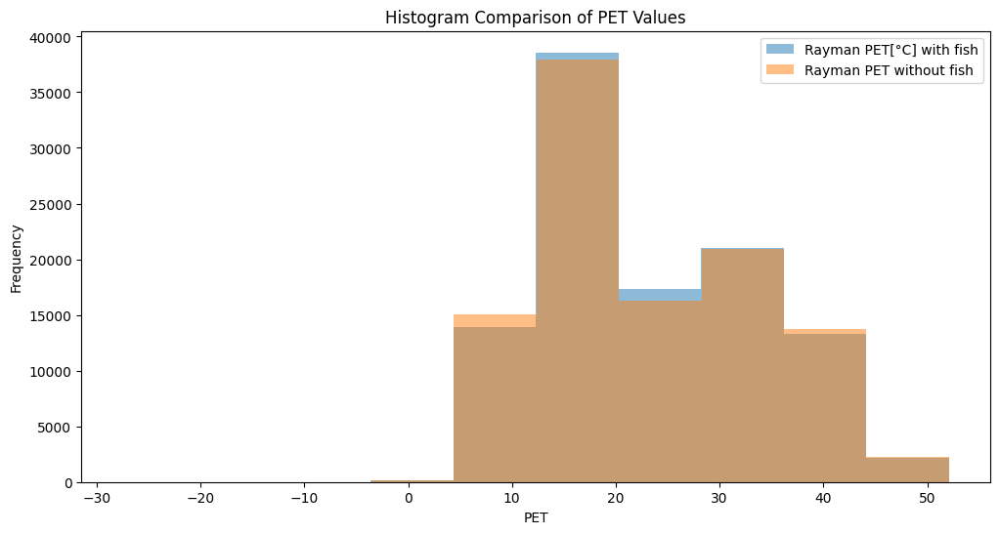

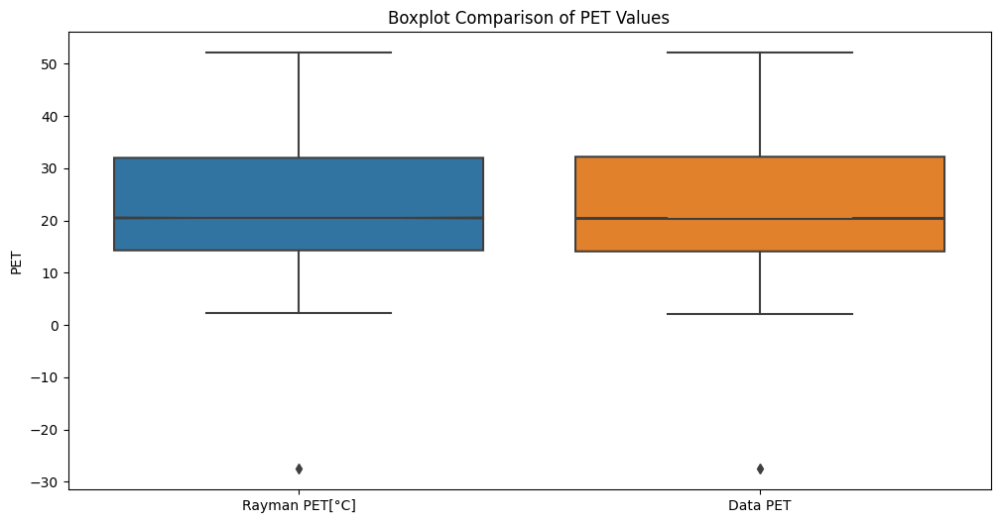

In [27]:
# Histograms for visual comparison
plt.figure(figsize=(12, 6))
plt.hist(rayman_output_df['PET[°C]'].dropna(), alpha=0.5, label='Rayman PET[°C] with fish')
plt.hist(output_without_fish['PET'].dropna(), alpha=0.5, label='Rayman PET without fish ')
plt.legend(loc='upper right')
plt.title('Histogram Comparison of PET Values')
plt.xlabel('PET')
plt.ylabel('Frequency')
plt.show()

# Boxplots for visual comparison
plt.figure(figsize=(12, 6))
sns.boxplot(data=[rayman_output_df['PET[°C]'].dropna(), output_without_fish['PET'].dropna()], notch=True)
plt.xticks([0, 1], ['Rayman PET[°C]', 'Data PET'])
plt.title('Boxplot Comparison of PET Values')
plt.ylabel('PET')
plt.show()


## Standard values of constant used in Rayman

- cloth 0.9 clo
- sex m 
- age 35 a
- weight 75.0 kg
- height 1.8 m 
- activity 80 W
- Ta air temp
- Tmrt mean radiant temp
- Ts surface temp 


In [44]:
columns_to_select = ['Temp', 'Humid', 'WindSpeed', 'PET Rayman']
output_without_fish.rename(columns={
            'date      ': 'Date',
            'time': 'Time',
            'Ta': 'Temp',
            'RH': 'Humid',
            'v': 'WindSpeed',
           'PET': 'PET Rayman'
        }, inplace=True)

selected_data = output_without_fish[columns_to_select]

# Convert the selected columns to numeric
numeric_data = selected_data.apply(pd.to_numeric, errors='coerce')
combined_dataframe = numeric_data

In [45]:
combined_dataframe

,Temp,Humid,WindSpeed,PET Rayman
0,19.0,89.0,1.1,13.7
1,18.7,91.0,0.9,13.6
2,18.6,92.0,1.1,13.3
3,18.6,92.0,1.1,13.3
4,18.6,93.0,0.9,13.5
...,...,...,...,...
106413,20.3,57.0,0.9,14.8
106414,20.1,57.0,1.4,14.3
106415,19.7,57.0,1.1,14.0
106416,19.1,58.0,0.8,13.6


In [46]:
result = check_dataframe_for_ml(combined_dataframe)
print("Missing Values:")
print(result['missing_values'])
print("Data Types:")
print(result['data_types'])
print("Non-numeric Columns:")
print(result['non_numeric_columns'])

Missing Values:
{'Temp': 0, 'Humid': 0, 'WindSpeed': 0, 'PET Rayman': 0}
Data Types:
{'Temp': dtype('float64'), 'Humid': dtype('float64'), 'WindSpeed': dtype('float64'), 'PET Rayman': dtype('float64')}
Non-numeric Columns:
[]


# Biometeo

In [47]:
# Define constants across python packages
activity = 80 # as in aug rayman
clo = 0.9   # Typical clothing insulation for indoor setting
p_atm = 1013.25  # Standard atmospheric pressure in hPa
position = 2 # standing 
age = 35 # from Rayman default 23
sex = 1 # default 1 male
weight = 75.0 # default 75 kg
met = 1.37 #activity/(weight*3.5) # Typical metabolic rate for sitting 1.37 max
height = 1.8 # default height in m
wme = 0 # default 0 external work W/m^2
position_bio = 1 # 1 is standing
longitude = 4 
latitude = 50
sea_level_height = 0

def calculate_vp_tmrt_pet(row):
    # Calculate VP for the row
    vp = biometeo.VP_RH_exchange(Ta=row['Temp'], VP=None, RH=row['Humid'])['VP']
    
    # Calculate Tmrt for the row
    tmrt = biometeo.Tmrt_calc(Ta=row['Temp'], RH=row['Humid'], v=row['WindSpeed'], longitude=longitude, latitude=latitude, sea_level_height=sea_level_height)['Tmrt']
    
    # Calculate PET for the row
    pet_result = biometeo.PET(
        Ta=row['Temp'],
        VP=vp,
        v=row['WindSpeed'],
        Tmrt=tmrt,
        icl=clo,
        work=met,
        ht=height,
        mbody=weight,
        age=age,
        sex=sex,
        pos=position_bio,
    )

    return pd.Series({'VP': vp, 'Tmrt': tmrt, 'PET biometeo': pet_result['PET_v']})

# Apply the function to calculate VP, Tmrt, and PET for each row and add them as new columns
combined_dataframe[['VP', 'Tmrt', 'PET biometeo']] = combined_dataframe.apply(calculate_vp_tmrt_pet, axis=1)

print(combined_dataframe.head())

   Temp  Humid  WindSpeed  PET Rayman         VP       Tmrt  PET biometeo
0  19.0   89.0        1.1        13.7  19.534198  45.791175        26.841
1  18.7   91.0        0.9        13.6  19.602981  24.848278        19.541
2  18.6   92.0        1.1        13.3  19.695001  28.124563        20.221
3  18.6   92.0        1.1        13.3  19.695001  28.124563        20.221
4  18.6   93.0        0.9        13.5  19.909077  30.621285        21.491


In [49]:
print(combined_dataframe.head())

   Temp  Humid  WindSpeed  PET Rayman         VP       Tmrt  PET biometeo
0  19.0   89.0        1.1        13.7  19.534198  45.791175        26.841
1  18.7   91.0        0.9        13.6  19.602981  24.848278        19.541
2  18.6   92.0        1.1        13.3  19.695001  28.124563        20.221
3  18.6   92.0        1.1        13.3  19.695001  28.124563        20.221
4  18.6   93.0        0.9        13.5  19.909077  30.621285        21.491


# Pythermalcomfort PET

https://pythermalcomfort.readthedocs.io/en/latest/reference/pythermalcomfort.html#physiological-equivalent-temperature-pet

Parameters
tdb (float) – dry bulb air temperature, [°C]

tr (float) – mean radiant temperature, [°C]

v (float) – air speed, [m/s]

rh (float) – relative humidity, [%]

met (float) – metabolic rate, [met]

clo (float) – clothing insulation, [clo]

p_atm (float) – atmospheric pressure, default value 1013.25 [hPa]

position (int) – position of the individual (1=sitting, 2=standing, 3=standing, forced convection)

age (int, default 23) – age in years

sex (int, default 1) – male (1) or female (2).

weight (float, default 75) – body mass, [kg]

height (float, default 1.8) – height, [m]

wme (float, default 0) – external work, [W/(m2)] default 0

In [60]:

# Create a function to calculate PET for a row of data
def calculate_pet(row):

# Calculate PET for the row
    pet = pet_steady(
        tdb=row['Temp'],
        tr=row['Tmrt'],  # Assuming tr = tdb for indoor setting
        v=row['WindSpeed'],
        rh=row['Humid'],
        met=met,
        clo=clo,
        p_atm=p_atm,
        position=position,
        age=age,
        sex=sex,
        weight=weight,
        height=height,
        wme=wme
    )
    return pet

# Apply the function to calculate PET for each row and add it as a new column
combined_dataframe['PET_Pythermalcomfort'] = combined_dataframe.apply(calculate_pet, axis=1)

print(combined_dataframe.head())


C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\scipy\optimize\_minpack_py.py:178: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\scipy\optimize\_minpack_py.py:178: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\scipy\optimize\_minpack_py.py:178: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache

# Combining all packages PET results

In [54]:
print(combined_dataframe[['PET Pythermalcomfort', 'PET biometeo', 'PET Rayman']].describe())

       PET Pythermalcomfort   PET biometeo     PET Rayman
count         106418.000000  106418.000000  106418.000000
mean              31.673967      32.311713      23.215874
std                6.830066       6.352673      10.529618
min              -27.360000     -20.951000     -27.400000
25%               26.640000      27.911000      14.100000
50%               31.800000      32.771000      20.400000
75%               36.800000      37.101000      32.200000
max               52.040000      49.111000      52.100000


## Violin and Histogram Plots

In [57]:
# Create violin plots for PET values
fig_violin = go.Figure()

fig_violin.add_trace(go.Violin(y=combined_dataframe['PET Pythermalcomfort'], name='PET Pythermalcomfort', box_visible=True, meanline_visible=True))
fig_violin.add_trace(go.Violin(y=combined_dataframe['PET biometeo'], name='PET Biometeo', box_visible=True, meanline_visible=True))
fig_violin.add_trace(go.Violin(y=combined_dataframe['PET Rayman'], name='PET Rayman', box_visible=True, meanline_visible=True))

fig_violin.update_layout(
    title_text='PET Values Violin Plot Comparison', 
    yaxis_title='PET Values',  
    legend=dict(
        x=0.1,
        y=1.1,
        orientation='h'
    )
)

fig_violin.show()

# Save the violin plot figure to HTML
fig_violin.write_html("PET_Values_Violin_Plot_Comparison.html")

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\nbformat\json_compat.py:14: DeprecationWarning:

Importing ErrorTree directly from the jsonschema package is deprecated and will become an ImportError. Import it from jsonschema.exceptions instead.

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\nbformat\json_compat.py:14: DeprecationWarning:

Importing ErrorTree directly from the jsonschema package is deprecated and will become an ImportError. Import it from jsonschema.exceptions instead.



C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\seaborn\_oldcore.py:1498: DeprecationWarning:

is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead

C:\Users\Lukasz\AppData\Local\Packages\PythonSoftwareFo

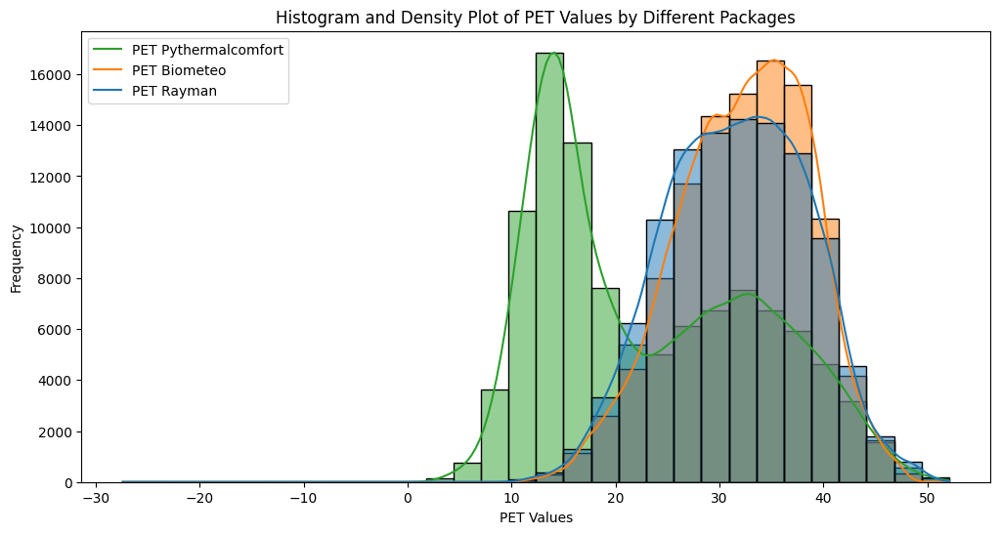

In [58]:
# Histogram with Density Plot
plt.figure(figsize=(12, 6))
sns.histplot(combined_dataframe[['PET Pythermalcomfort', 'PET biometeo', 'PET Rayman']], kde=True, bins=30)
plt.xlabel('PET Values')
plt.ylabel('Frequency')
plt.title('Histogram and Density Plot of PET Values by Different Packages')
plt.legend(labels=['PET Pythermalcomfort', 'PET Biometeo', 'PET Rayman'])
plt.show()


In [52]:
rayman_output_df.head()

,date [d.m.yyyy ],day of[year],time[h:mm],sunr.[h:mm],sunset[h:mm],SDmax[min],SDact[min],elev.[°],azim.[°],SVF_Ray[nan],SVF_cos[nan],LTF[nan],Albedo[nan],Bowen[nan],Gmax[W/m²],Gact[W/m²],Sact[W/m²],Dact[W/m²],A[W/m²],E[W/m²],Ts[°C],Ta[°C],VP[hPa],RH[%],v[m/s],C[octas],Tmrt[°C],height[m],weight[kg],age[a],sex[nan],cloth.[clo],activ.[W],PET[°C],UTCI[°C],PT[°C]
0,1.8.2022,213,0:00,5:08,20:29,921,917,-20.3,347.7,1.0,1.0,4.3,0.3,1.0,0.0,0.0,0.0,0.0,337.2,399.0,17.1,19.0,19.5,89.0,1.1,0.0,10.7,1.8,75.0,35,m,0.90,80.0,13.7,16.7,13.3
1,1.8.2022,213,0:30,5:08,20:29,921,917,-21.0,355.3,1.0,1.0,6.2,0.3,1.0,0.0,0.0,0.0,0.0,335.9,396.7,16.6,18.7,19.6,91.0,0.9,0.0,10.4,1.8,75.0,35,m,0.90,80.0,13.5,16.9,13.3
2,1.8.2022,213,1:00,5:08,20:29,921,917,-21.1,2.9,1.0,1.0,8.6,0.3,1.0,0.0,0.0,0.0,0.0,335.4,396.9,16.7,18.6,19.7,92.0,1.1,0.0,10.3,1.8,75.0,35,m,0.90,80.0,13.3,16.4,13.0
3,1.8.2022,213,1:30,5:08,20:29,921,917,-20.5,10.5,1.0,1.0,8.6,0.3,1.0,0.0,0.0,0.0,0.0,335.4,396.9,16.7,18.6,19.7,92.0,1.1,0.0,10.3,1.8,75.0,35,m,0.90,80.0,13.3,16.4,13.0
4,1.8.2022,213,2:00,5:08,20:29,921,917,-19.3,18.0,1.0,1.0,13.0,0.3,1.0,0.0,0.0,0.0,0.0,335.5,396.2,16.5,18.6,19.9,93.0,0.9,0.0,10.3,1.8,75.0,35,m,0.90,80.0,13.4,16.9,13.2


In [ ]:
rayman_output_df.rename(columns={'PET[°C]': 'PET Rayman with fish'}, inplace=True)
rayman_output_df.rename(columns={'Tmrt[°C]': 'Tmrt Rayman with fish'}, inplace=True)
rayman_output_df.rename(columns={'VP[hPa]': 'VP Rayman with fish'}, inplace=True)

: 

In [ ]:
# Rename the 'PET' column in the 'data' dataframe to 'PET Rayman'
output_without_fish.rename(columns={'PET': 'PET Rayman without fish'}, inplace=True)
output_without_fish.rename(columns={'Tmrt': 'Tmrt Rayman without fish'}, inplace=True)
output_without_fish.rename(columns={'VP': 'VP Rayman without fish'}, inplace=True)

: 

In [ ]:
output_without_fish.columns

: 

In [ ]:
# Merge the two dataframes based on their index (rows)
combined_dataframe = pd.concat([combined_dataframe, output_without_fish[['PET Rayman without fish', 'Tmrt Rayman without fish', 'VP Rayman without fish']]], axis=1)
combined_dataframe = pd.concat([combined_dataframe, rayman_output_df[['PET Rayman with fish', 'Tmrt Rayman with fish', 'VP Rayman with fish']]], axis=1)

: 

In [ ]:
rayman001.rename(columns={'PET[°C]': 'PET[°C] 0.001SVF'}, inplace=True)
rayman104.rename(columns={'PET[°C]': 'PET[°C] 0.104SVF'}, inplace=True)
rayman544.rename(columns={'PET[°C]': 'PET[°C] 0.544SVF'}, inplace=True)
rayman795.rename(columns={'PET[°C]': 'PET[°C] 0.795SVF'}, inplace=True)
combined_dataframe = pd.concat([combined_dataframe, rayman001[['PET[°C] 0.001SVF']]], axis=1)
combined_dataframe = pd.concat([combined_dataframe, rayman104[['PET[°C] 0.104SVF']]], axis=1)
combined_dataframe = pd.concat([combined_dataframe, rayman544[['PET[°C] 0.544SVF']]], axis=1)
combined_dataframe = pd.concat([combined_dataframe, rayman795[['PET[°C] 0.795SVF']]], axis=1)

: 

In [ ]:
combined_dataframe

: 

In [ ]:
combined_dataframe.to_excel('PackagesDataframe.xlsx', index=False)

: 